In [ ]:
import os
import zipfile
from concurrent.futures import ThreadPoolExecutor

import gdown
import kagglehub
import numpy as np
from sklearn.model_selection import train_test_split

from datasets import load_dataset
from src.data_preparation_utils import RESULTS_DIR, save_batch
from src.data_utils import process_image
from src.utils import plot_images

# Our dataset

In [2]:
train_length = val_length = test_length = 0
sample_images = sample_labels = None

for file in os.listdir(RESULTS_DIR):
    if "train_" in file:
        data = np.load(os.path.join(RESULTS_DIR, file))

        if sample_images is None:
            sample_images = data["images"][:20]
            sample_labels = data["labels"][:20]

        train_length += len(data["images"])

    elif "val" in file:
        data = np.load(os.path.join(RESULTS_DIR, file))
        val_length += len(data["images"])

    elif "test" in file:
        data = np.load(os.path.join(RESULTS_DIR, file))
        test_length += len(data["images"])

print(f"Train length: {train_length}")
print(f"Validation length: {val_length}")
print(f"Test length: {test_length}")

Train length: 80000
Validation length: 10000
Test length: 10000


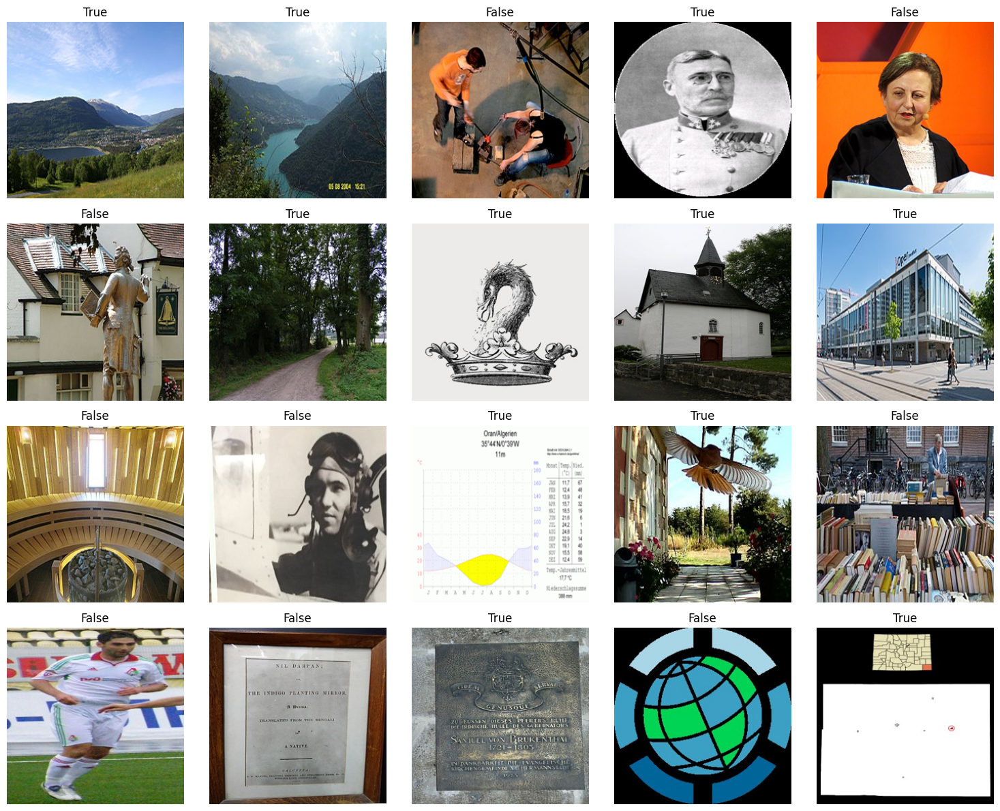

In [3]:
plot_images(
    sample_images,
    ncols=5,
    labels=sample_labels,
)

Labels are not the best, but we won't get any better with existing small open source models. Further work for that project would be for sure trying to generate better dataset using state-of-the-art MLLMs like chatgpt o3. However, providing required length of the dataset, it won't be cheap. Moreover, this dataset should be filtered out of images irrelevant to the cause, ex charts, maps, paintings and more.

# Additional datasets

We'll use all 'good' images for training, and latter upper poorer dataset for further training - at each iteration besides training we'll try to remove instances that are most likely irrelevant for our project.

In [ ]:
def save(
    name: str, images: np.ndarray, labels: np.ndarray, batch_size: int = 1000
) -> None:
    """
    Save the images and labels to a file.
    """
    train, val_test = train_test_split(
        np.arange(len(images)),
        test_size=0.2,
        random_state=42,
    )
    val, test = train_test_split(
        val_test,
        test_size=0.5,
        random_state=42,
    )

    print(f"Train length: {len(train)}")
    print(f"Validation length: {len(val)}")
    print(f"Test length: {len(test)}")

    for portion_name, portion in zip(["train", "val", "test"], [train, val, test]):
        images = images[portion]
        labels = labels[portion]

        images_batches = [
            images[i : i + batch_size] for i in range(0, len(portion), batch_size)
        ]
        labels_batches = [
            labels[i : i + batch_size] for i in range(0, len(portion), batch_size)
        ]

        for i, (images_batch, labels_batch) in enumerate(
            zip(images_batches, labels_batches)
        ):
            save_batch(
                i,
                images_batch,
                labels_batch,
                f"{name}_{portion_name}",
            )

## [Indoor-Outdoor Net](https://huggingface.co/datasets/prithivMLmods/IndoorOutdoorNet-20K)

Number of images: 19998


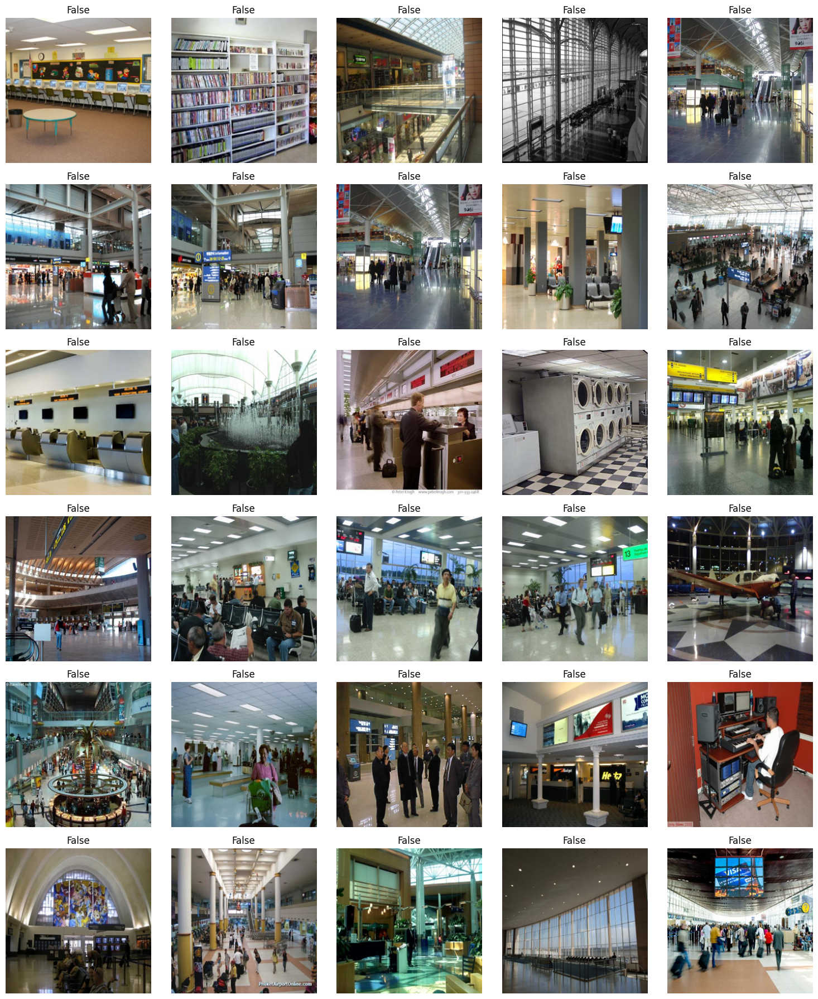

In [4]:
dataset = load_dataset("prithivMLmods/IndoorOutdoorNet-20K")

images = dataset["train"]["image"]
labels = np.array(dataset["train"]["label"], dtype=np.bool_)

print(f"Number of images: {len(images)}")

with ThreadPoolExecutor() as executor:
    images = np.array(list(executor.map(process_image, images)))

plot_images(
    images[:30],
    ncols=5,
    labels=labels[:30],
)

In [ ]:
save("indoor-outdoor", images, labels)

(19998, 256, 256, 3)
(19998,)


## [MIT Indoor Scenes](https://www.kaggle.com/datasets/itsahmad/indoor-scenes-cvpr-2019)

In [6]:
path = kagglehub.dataset_download("itsahmad/indoor-scenes-cvpr-2019")

os.listdir(path)

['TrainImages.txt',
 'TestImages.txt',
 'indoorCVPR_09',
 'indoorCVPR_09annotations']

Number of images: 15619


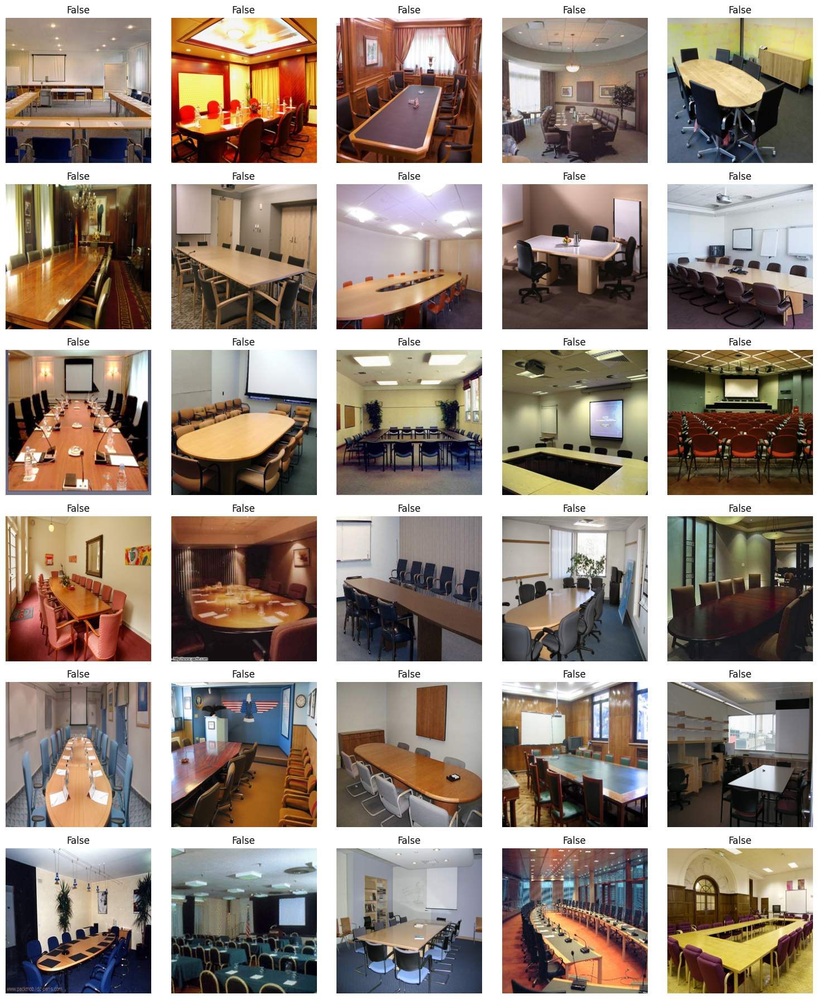

In [7]:
dir_path = os.path.join(path, "indoorCVPR_09")
image_paths = []
for root_dir, dirs, files in os.walk(dir_path):
    for file in files:
        if file.lower().endswith(".jpg"):
            image_paths.append(os.path.join(root_dir, file))

print(f"Number of images: {len(image_paths)}")

with ThreadPoolExecutor() as executor:
    images = np.array(list(executor.map(process_image, image_paths)))
labels = np.zeros(len(images), dtype=np.bool_)

plot_images(
    images[:30],
    ncols=5,
    labels=labels[:30],
)

In [ ]:
save("mit", images, labels)

(15619, 256, 256, 3)
(15619,)


## [Landsaping Pictures](https://www.kaggle.com/datasets/arnaud58/landscape-pictures)

Number of images: 4319


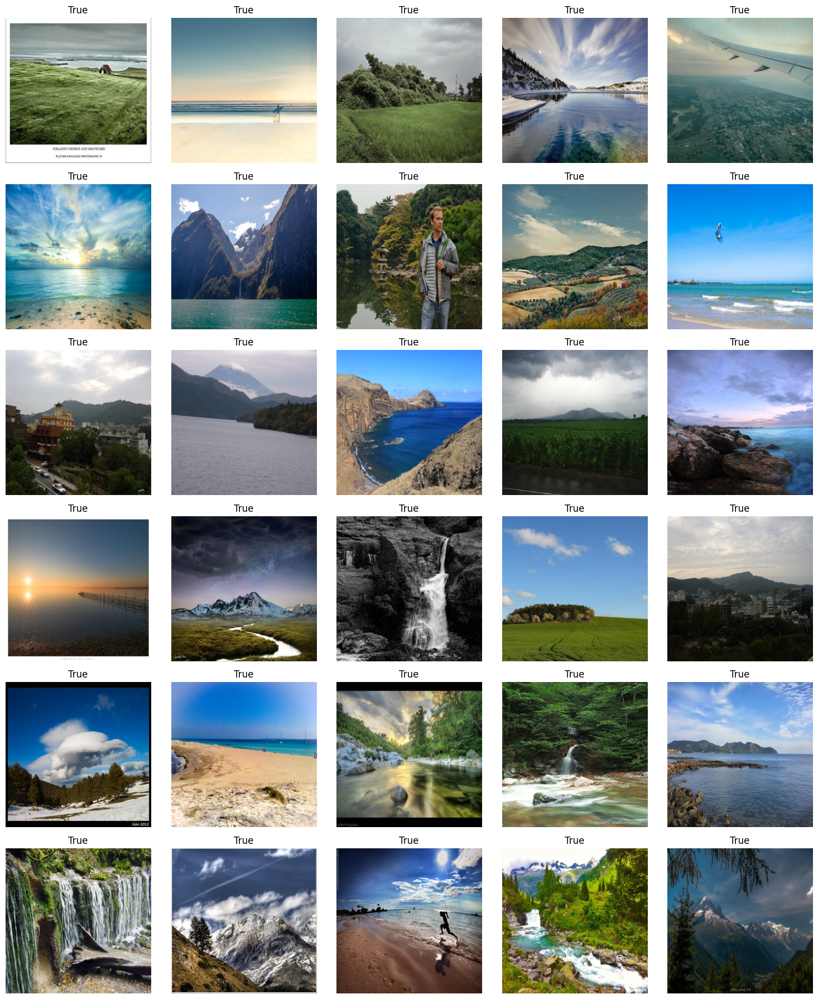

In [ ]:
path = kagglehub.dataset_download("arnaud58/landscape-pictures")

image_paths = [
    os.path.join(path, f) for f in os.listdir(path) if f.lower().endswith(".jpg")
]

print(f"Number of images: {len(image_paths)}")

with ThreadPoolExecutor() as executor:
    images = np.array(list(executor.map(process_image, image_paths)))
labels = np.ones(len(images), dtype=np.bool_)

plot_images(
    images[:30],
    ncols=5,
    labels=labels[:30],
)

In [ ]:
save("landscape", images, labels)

(4319, 256, 256, 3)
(4319,)


## [OST 300](https://paperswithcode.com/dataset/ost300)

In [11]:
output_dir = os.path.join(RESULTS_DIR, "ost-300")

if not os.path.exists(output_dir):
    os.makedirs(output_dir, exist_ok=True)
    folder_url = (
        "https://drive.google.com/drive/folders/16PIViLkv4WsXk4fV1gDHvEtQxdMq6nfY"
    )
    gdown.download_folder(
        url=folder_url, output=output_dir, quiet=False, use_cookies=False
    )

    for file_name in os.listdir(output_dir):
        if file_name.lower().endswith(".zip"):
            zip_path = os.path.join(output_dir, file_name)
            print(f"Extracting {zip_path}...")
            with zipfile.ZipFile(zip_path, "r") as z:
                z.extractall(output_dir)
            os.remove(zip_path)

Number of images: 10324


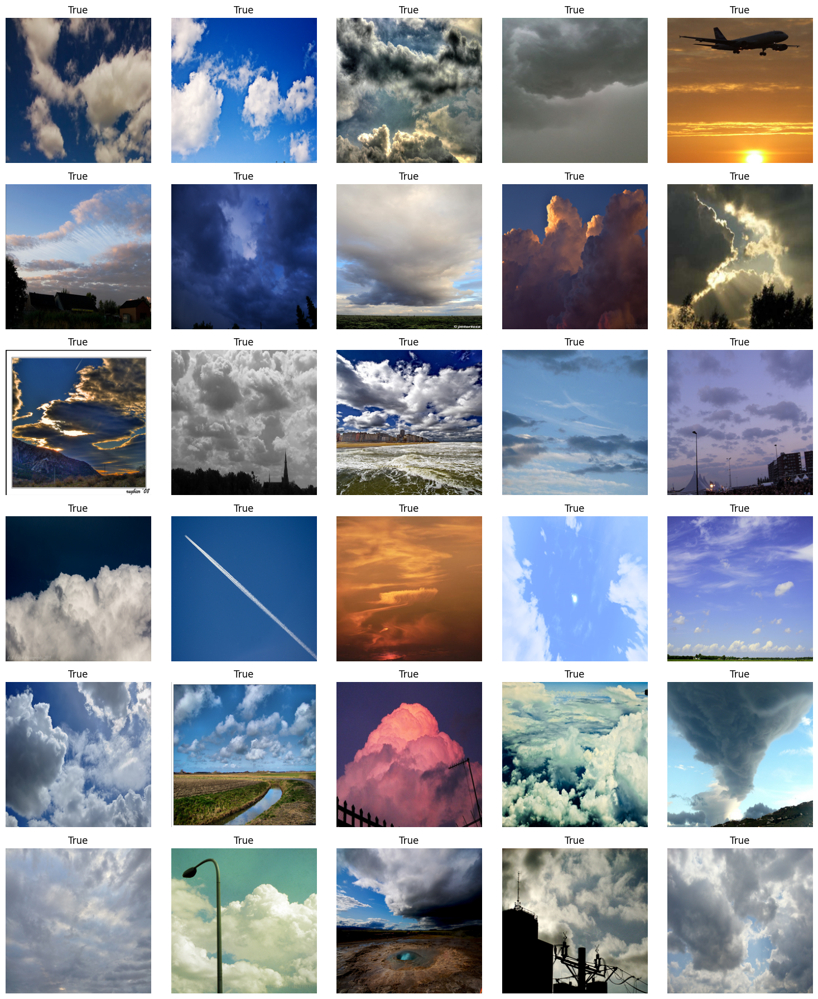

In [12]:
image_paths = []
for root_dir, dirs, files in os.walk(output_dir):
    for file in files:
        if file.lower().endswith(".png"):
            image_paths.append(os.path.join(root_dir, file))

print(f"Number of images: {len(image_paths)}")

with ThreadPoolExecutor() as executor:
    images = np.array(list(executor.map(process_image, image_paths)))
labels = np.ones(len(images), dtype=np.bool_)

plot_images(
    images[:30],
    ncols=5,
    labels=labels[:30],
)

In [ ]:
save("landscape", images, labels)

(10324, 256, 256, 3)
(10324,)
